#Python Libraries

In [164]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn import metrics
import seaborn as seabornInstance 
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import accuracy_score
from sklearn.metrics import mean_absolute_error
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
%matplotlib inline

In [165]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [166]:
df1 =pd.read_csv('/content/drive/MyDrive/Spotify/data/track_features/tf_mini.csv')
df = pd.read_csv('/content/drive/MyDrive/Spotify/data/training_set/log_mini.csv')
 

#Spotify Data EDA
Exploratory Data Analysis or (EDA) is understanding the data sets by summarizing their main characteristics often plotting them visually.

In [167]:
df.head()

,session_id,session_position,session_length,track_id_clean,skip_1,skip_2,skip_3,not_skipped,context_switch,no_pause_before_play,...,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,hist_user_behavior_is_shuffle,hour_of_day,date,premium,context_type,hist_user_behavior_reason_start,hist_user_behavior_reason_end
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,False,False,False,True,0,0,...,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone
1,0_00006f66-33e5-4de7-a324-2d18e439fc1e,2,20,t_9099cd7b-c238-47b7-9381-f23f2c1d1043,False,False,False,True,0,1,...,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone
2,0_00006f66-33e5-4de7-a324-2d18e439fc1e,3,20,t_fc5df5ba-5396-49a7-8b29-35d0d28249e0,False,False,False,True,0,1,...,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone
3,0_00006f66-33e5-4de7-a324-2d18e439fc1e,4,20,t_23cff8d6-d874-4b20-83dc-94e450e8aa20,False,False,False,True,0,1,...,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone
4,0_00006f66-33e5-4de7-a324-2d18e439fc1e,5,20,t_64f3743c-f624-46bb-a579-0f3f9a07a123,False,False,False,True,0,1,...,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone


In [168]:
for colname in ['skip_1','skip_2','skip_3','not_skipped','hist_user_behavior_is_shuffle','premium']:
    df[colname] = df[colname].astype(int,copy=False)

In [169]:
df.head()

,session_id,session_position,session_length,track_id_clean,skip_1,skip_2,skip_3,not_skipped,context_switch,no_pause_before_play,...,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,hist_user_behavior_is_shuffle,hour_of_day,date,premium,context_type,hist_user_behavior_reason_start,hist_user_behavior_reason_end
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,0,1,0,0,...,0,0,0,1,16,2018-07-15,1,editorial_playlist,trackdone,trackdone
1,0_00006f66-33e5-4de7-a324-2d18e439fc1e,2,20,t_9099cd7b-c238-47b7-9381-f23f2c1d1043,0,0,0,1,0,1,...,0,0,0,1,16,2018-07-15,1,editorial_playlist,trackdone,trackdone
2,0_00006f66-33e5-4de7-a324-2d18e439fc1e,3,20,t_fc5df5ba-5396-49a7-8b29-35d0d28249e0,0,0,0,1,0,1,...,0,0,0,1,16,2018-07-15,1,editorial_playlist,trackdone,trackdone
3,0_00006f66-33e5-4de7-a324-2d18e439fc1e,4,20,t_23cff8d6-d874-4b20-83dc-94e450e8aa20,0,0,0,1,0,1,...,0,0,0,1,16,2018-07-15,1,editorial_playlist,trackdone,trackdone
4,0_00006f66-33e5-4de7-a324-2d18e439fc1e,5,20,t_64f3743c-f624-46bb-a579-0f3f9a07a123,0,0,0,1,0,1,...,0,0,0,1,16,2018-07-15,1,editorial_playlist,trackdone,trackdone


In [170]:
df.dtypes

session_id                         object
session_position                    int64
session_length                      int64
track_id_clean                     object
skip_1                              int64
skip_2                              int64
skip_3                              int64
not_skipped                         int64
context_switch                      int64
no_pause_before_play                int64
short_pause_before_play             int64
long_pause_before_play              int64
hist_user_behavior_n_seekfwd        int64
hist_user_behavior_n_seekback       int64
hist_user_behavior_is_shuffle       int64
hour_of_day                         int64
date                               object
premium                             int64
context_type                       object
hist_user_behavior_reason_start    object
hist_user_behavior_reason_end      object
dtype: object

In [171]:
col = ['skip_1','skip_2','skip_3',
       'not_skipped','context_switch','no_pause_before_play',
       'short_pause_before_play','long_pause_before_play','hist_user_behavior_is_shuffle',
       'premium']

In [172]:
df.describe()

,session_position,session_length,skip_1,skip_2,skip_3,not_skipped,context_switch,no_pause_before_play,short_pause_before_play,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,hist_user_behavior_is_shuffle,hour_of_day,premium
count,167880.000000,167880.000000,167880.000000,167880.000000,167880.000000,167880.000000,167880.000000,167880.000000,167880.000000,167880.000000,167880.000000,167880.000000,167880.000000,167880.000000,167880.000000
mean,9.325911,17.651823,0.421503,0.517179,0.648380,0.332881,0.040904,0.767602,0.146635,0.172832,0.038909,0.046259,0.308732,14.193084,0.810418
std,5.457638,3.422025,0.493801,0.499706,0.477478,0.471246,0.198069,0.422363,0.353742,0.378103,0.367295,0.606558,0.461972,5.996243,0.391971
min,1.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,15.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,11.000000,1.000000
50%,9.000000,20.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,15.000000,1.000000
75%,14.000000,20.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,19.000000,1.000000
max,20.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,60.000000,151.000000,1.000000,23.000000,1.000000


In [173]:
df.describe(include=['O'])

,session_id,track_id_clean,date,context_type,hist_user_behavior_reason_start,hist_user_behavior_reason_end
count,167880,167880,167880,167880,167880,167880
unique,10000,50704,18,6,9,7
top,0_0d0c8a6a-d4da-4238-80ba-17334e4d2001,t_bacf06d3-9185-4183-84ea-ff0db51475ce,2018-07-15,user_collection,fwdbtn,fwdbtn
freq,20,1427,119639,67430,79912,81389


In [174]:
col = ['skip_1','skip_2','skip_3',
       'not_skipped','context_switch','no_pause_before_play',
       'short_pause_before_play','long_pause_before_play','hist_user_behavior_is_shuffle',
       'premium','context_switch','hist_user_behavior_reason_start',
       'hist_user_behavior_reason_end']

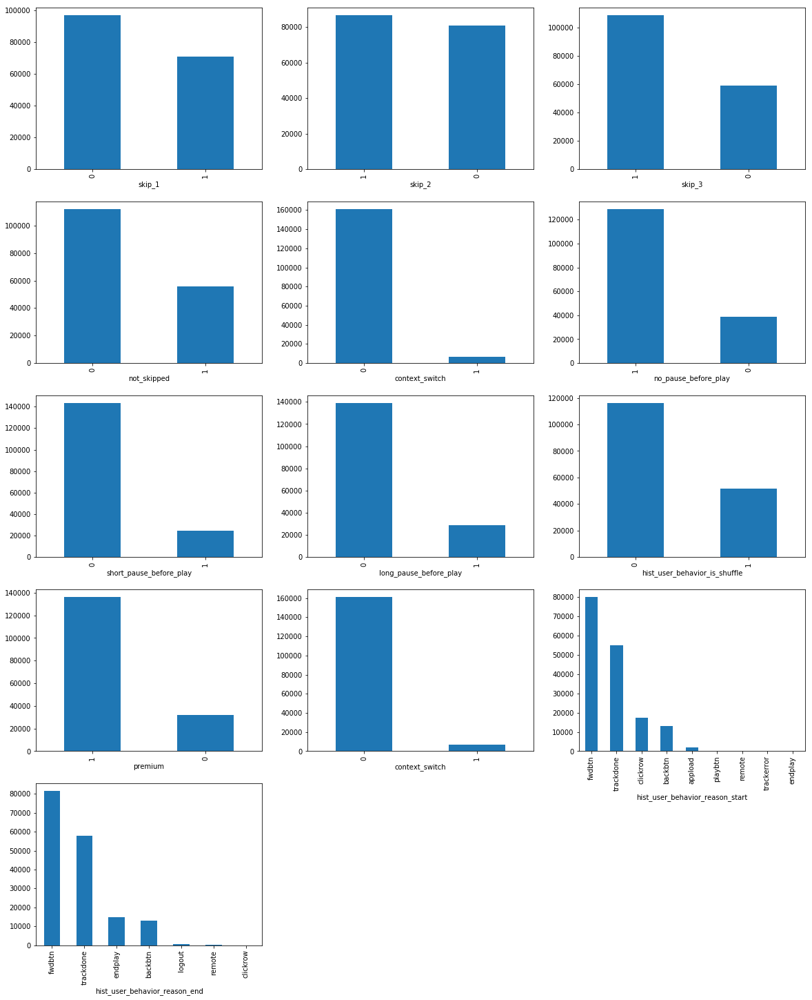

In [175]:
plt.figure(figsize=(20,25))
n = 1
for colname in col:
    plt.subplot(5,3,n)
    df[colname].value_counts().plot('bar')
    plt.xlabel(colname)
    n +=1

In [176]:

df_without_session_track = df.drop(['session_id', 'track_id_clean'], axis=1)

In [177]:
df_without_session_track.shape

(167880, 19)

In [178]:
df_without_session_track = pd.get_dummies(df_without_session_track)

In [179]:
df_without_session_track.shape

(167880, 55)

In [180]:
correlation = df_without_session_track.corr()

In [181]:
correlation['not_skipped'].sort_values()

skip_3                                       -0.959225
skip_2                                       -0.731088
hist_user_behavior_reason_end_fwdbtn         -0.680506
skip_1                                       -0.602966
hist_user_behavior_reason_start_fwdbtn       -0.383116
hist_user_behavior_reason_end_endplay        -0.209849
hist_user_behavior_reason_end_backbtn        -0.203256
short_pause_before_play                      -0.126978
long_pause_before_play                       -0.092755
hist_user_behavior_reason_start_backbtn      -0.066307
session_length                               -0.059734
hist_user_behavior_n_seekfwd                 -0.052323
hist_user_behavior_reason_end_logout         -0.039445
hist_user_behavior_reason_start_appload      -0.036226
hist_user_behavior_is_shuffle                -0.030787
context_type_user_collection                 -0.029191
hist_user_behavior_reason_end_remote         -0.027876
context_type_radio                           -0.023680
date_2018-

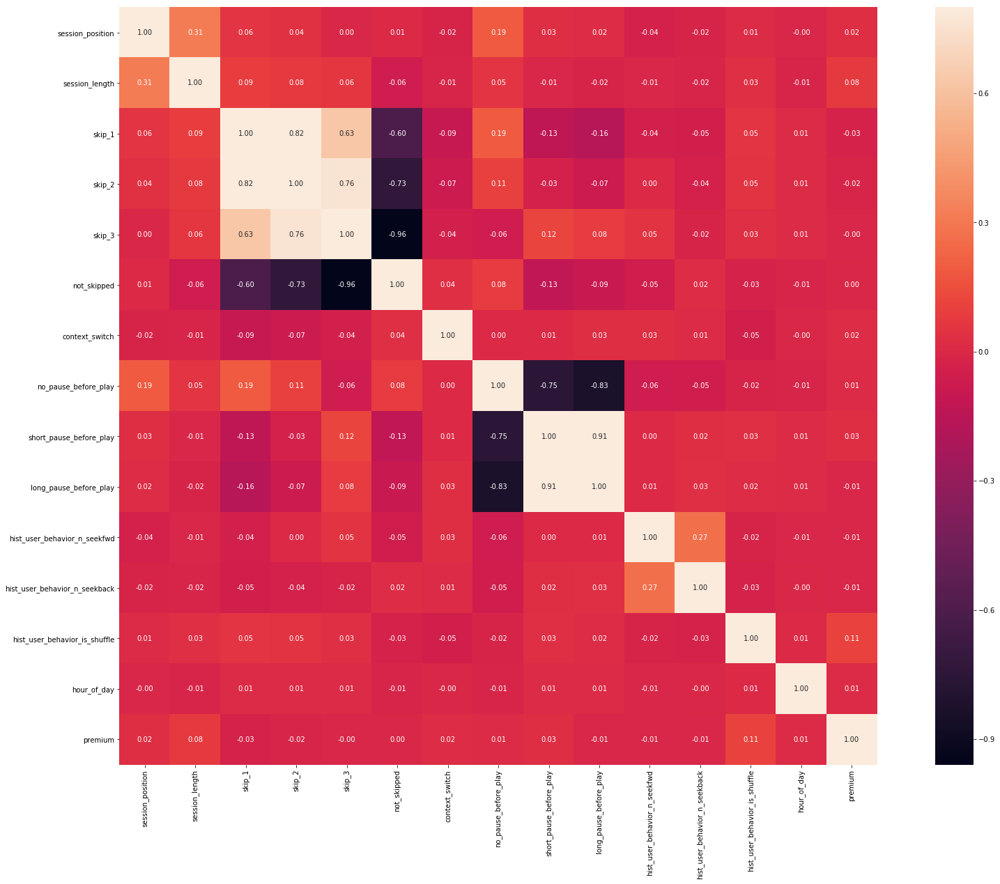

In [182]:
corrmat=df.corr()
f, ax = plt.subplots(figsize=(30, 20))
sns.heatmap(corrmat,cbar=True, annot=True, vmax=.8, square=True, fmt='.2f', annot_kws={'size': 10});

In [183]:
col = ['track_id','duration','release_year','us_popularity_estimate','acousticness','beat_strength','bounciness',
          'danceability','dyn_range_mean','energy','flatness','instrumentalness','key','liveness','loudness',
          'mechanism','mode','organism','speechiness','tempo','time_signature','valence','acoustic_vector_0',
          'acoustic_vector_1','acoustic_vector_2','acoustic_vector_3','acoustic_vector_4','acoustic_vector_5',
          'acoustic_vector_6','acoustic_vector_7']

In [184]:
df1.columns = col

In [185]:
df1.head()

,track_id,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,...,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
0,t_a540e552-16d4-42f8-a185-232bd650ea7d,109.706673,1950,99.975414,0.458040,0.519497,0.504949,0.399767,7.511880,0.817709,...,4,0.935512,-0.033284,-0.411896,-0.028580,0.349438,0.832467,-0.213871,-0.299464,-0.675907
1,t_67965da0-132b-4b1e-8a69-0ef99b32287c,187.693329,1950,99.969430,0.916272,0.419223,0.545530,0.491235,9.098376,0.154258,...,3,0.359675,0.145703,-0.850372,0.123860,0.746904,0.371803,-0.420558,-0.213120,-0.525795
2,t_0614ecd3-a7d5-40a1-816e-156d5872a467,160.839996,1951,99.602549,0.812884,0.425890,0.508280,0.491625,8.368670,0.358813,...,4,0.726769,0.021720,-0.743634,0.333247,0.568447,0.411094,-0.187749,-0.387599,-0.433496
3,t_070a63a0-744a-434e-9913-a97b02926a29,175.399994,1951,99.665018,0.396854,0.400934,0.359990,0.552227,5.967346,0.514585,...,4,0.859075,0.039143,-0.267555,-0.051825,0.106173,0.614825,-0.111419,-0.265953,-0.542753
4,t_d6990e17-9c31-4b01-8559-47d9ce476df1,369.600006,1951,99.991764,0.728831,0.371328,0.335115,0.483044,5.802681,0.721442,...,4,0.562343,0.131931,-0.292523,-0.174819,-0.034422,0.717229,-0.016239,-0.392694,-0.455496


In [186]:
df1.describe()

,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,...,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
count,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000,...,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000,50704.000000
mean,222.267980,2010.324748,99.455131,0.250336,0.492075,0.514526,0.611742,8.215950,0.641440,0.996548,...,3.913163,0.487804,-0.332295,0.202193,0.153935,-0.040526,-0.027247,0.049475,-0.197758,0.005153
std,72.224839,11.471866,1.139222,0.276047,0.158102,0.182595,0.166146,2.410626,0.207957,0.045611,...,0.410036,0.246376,0.416320,0.254024,0.212660,0.333129,0.377457,0.144205,0.349840,0.324259
min,30.013330,1950.000000,90.018900,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,-1.122792,-1.084360,-0.752231,-0.809136,-1.029858,-0.942461,-0.736395,-0.975647
25%,183.933334,2009.000000,99.509670,0.025291,0.374378,0.372463,0.502499,6.356671,0.507839,0.975910,...,4.000000,0.292559,-0.745148,0.086460,0.051604,-0.294574,-0.318751,-0.038337,-0.444849,-0.176821
50%,214.866669,2015.000000,99.865444,0.135821,0.493764,0.522266,0.625145,8.015075,0.661368,1.003790,...,4.000000,0.478244,-0.334799,0.265535,0.207705,-0.001755,-0.176974,0.062719,-0.298599,0.090423
75%,250.426666,2017.000000,99.961131,0.406142,0.604994,0.655912,0.736241,9.792092,0.803185,1.026137,...,4.000000,0.677947,0.045921,0.359553,0.296132,0.146828,0.280852,0.160366,-0.075158,0.194285
max,1787.760986,2018.000000,99.999997,0.995796,0.990419,0.972590,0.984952,32.342781,0.999877,1.103213,...,5.000000,0.999990,0.932165,0.812837,0.605288,1.074504,0.895769,0.380279,0.966760,1.152213


In [187]:
df1.describe(include=['O'])

,track_id,mode
count,50704,50704
unique,50704,2
top,t_d9f98a94-84a6-4e5f-bcb8-7be7bb59078b,major
freq,1,32555


In [188]:
df1.dtypes

track_id                   object
duration                  float64
release_year                int64
us_popularity_estimate    float64
acousticness              float64
beat_strength             float64
bounciness                float64
danceability              float64
dyn_range_mean            float64
energy                    float64
flatness                  float64
instrumentalness          float64
key                         int64
liveness                  float64
loudness                  float64
mechanism                 float64
mode                       object
organism                  float64
speechiness               float64
tempo                     float64
time_signature              int64
valence                   float64
acoustic_vector_0         float64
acoustic_vector_1         float64
acoustic_vector_2         float64
acoustic_vector_3         float64
acoustic_vector_4         float64
acoustic_vector_5         float64
acoustic_vector_6         float64
acoustic_vecto

In [189]:
df1.isnull().sum()

track_id                  0
duration                  0
release_year              0
us_popularity_estimate    0
acousticness              0
beat_strength             0
bounciness                0
danceability              0
dyn_range_mean            0
energy                    0
flatness                  0
instrumentalness          0
key                       0
liveness                  0
loudness                  0
mechanism                 0
mode                      0
organism                  0
speechiness               0
tempo                     0
time_signature            0
valence                   0
acoustic_vector_0         0
acoustic_vector_1         0
acoustic_vector_2         0
acoustic_vector_3         0
acoustic_vector_4         0
acoustic_vector_5         0
acoustic_vector_6         0
acoustic_vector_7         0
dtype: int64

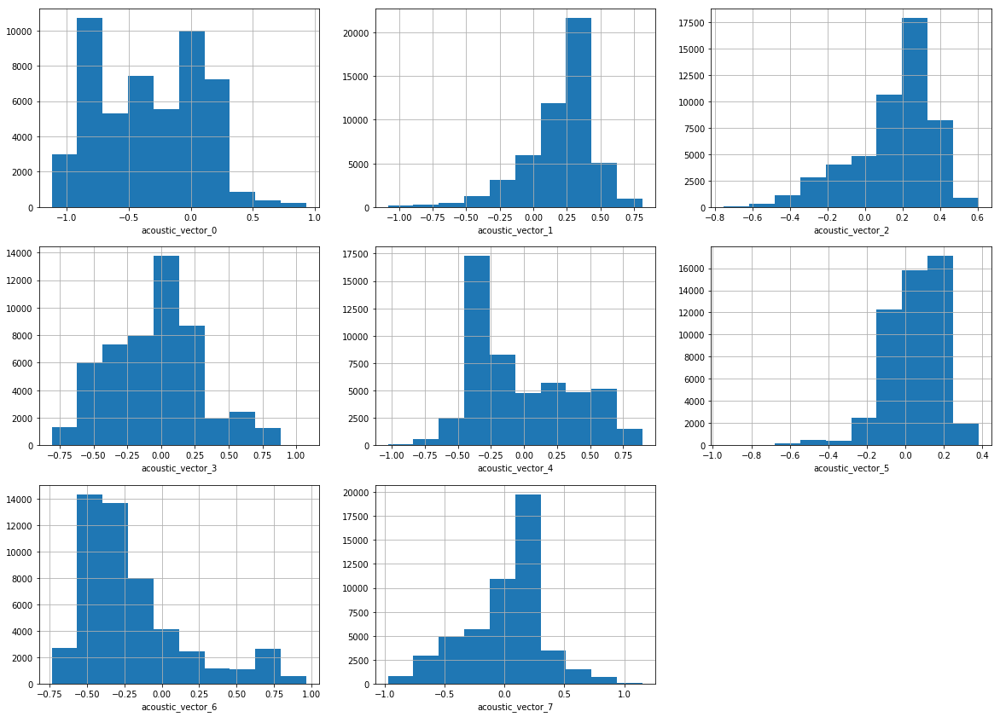

In [190]:
plt.figure(figsize=(20,30))
n = 1

for colname in ['acoustic_vector_0','acoustic_vector_1','acoustic_vector_2',
                'acoustic_vector_3','acoustic_vector_4','acoustic_vector_5',
                'acoustic_vector_6','acoustic_vector_7']:
    plt.subplot(6,3,n)
    df1[colname].hist()
    plt.xlabel(colname)
    n +=1

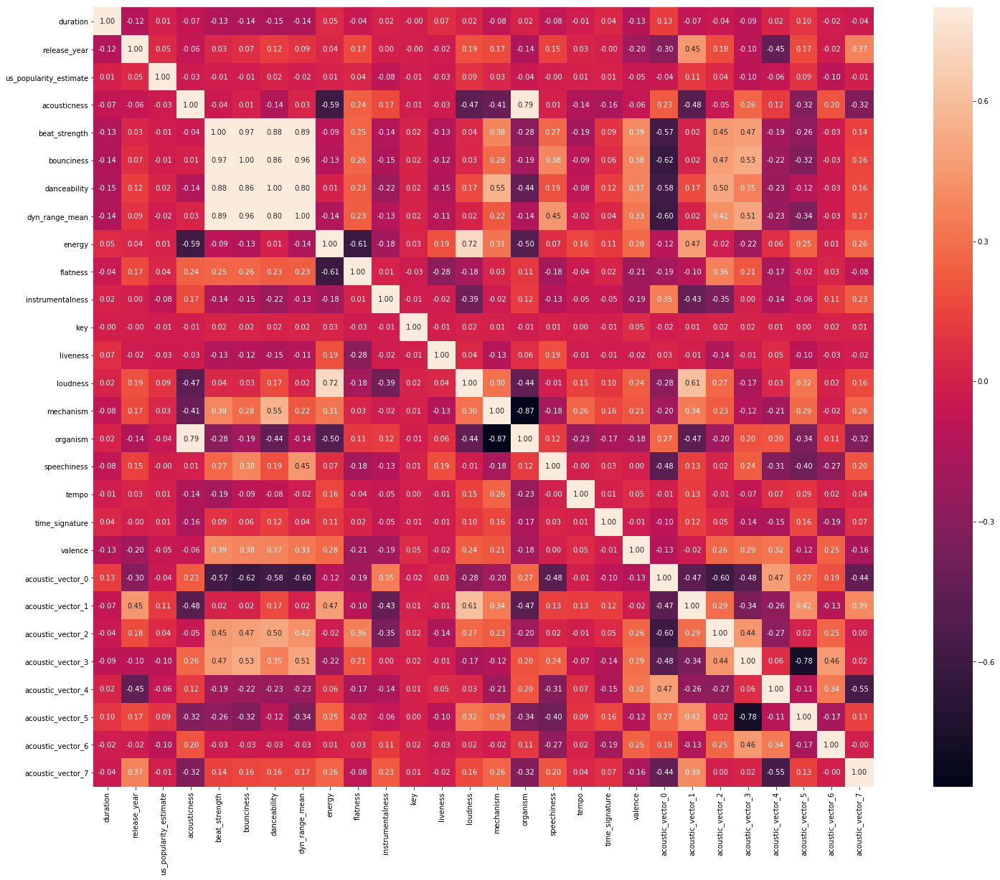

In [192]:
corrmat=df1.corr()
f, ax = plt.subplots(figsize=(30, 20))
sns.heatmap(corrmat,cbar=True, annot=True, vmax=.8, square=True, fmt='.2f', annot_kws={'size': 10});

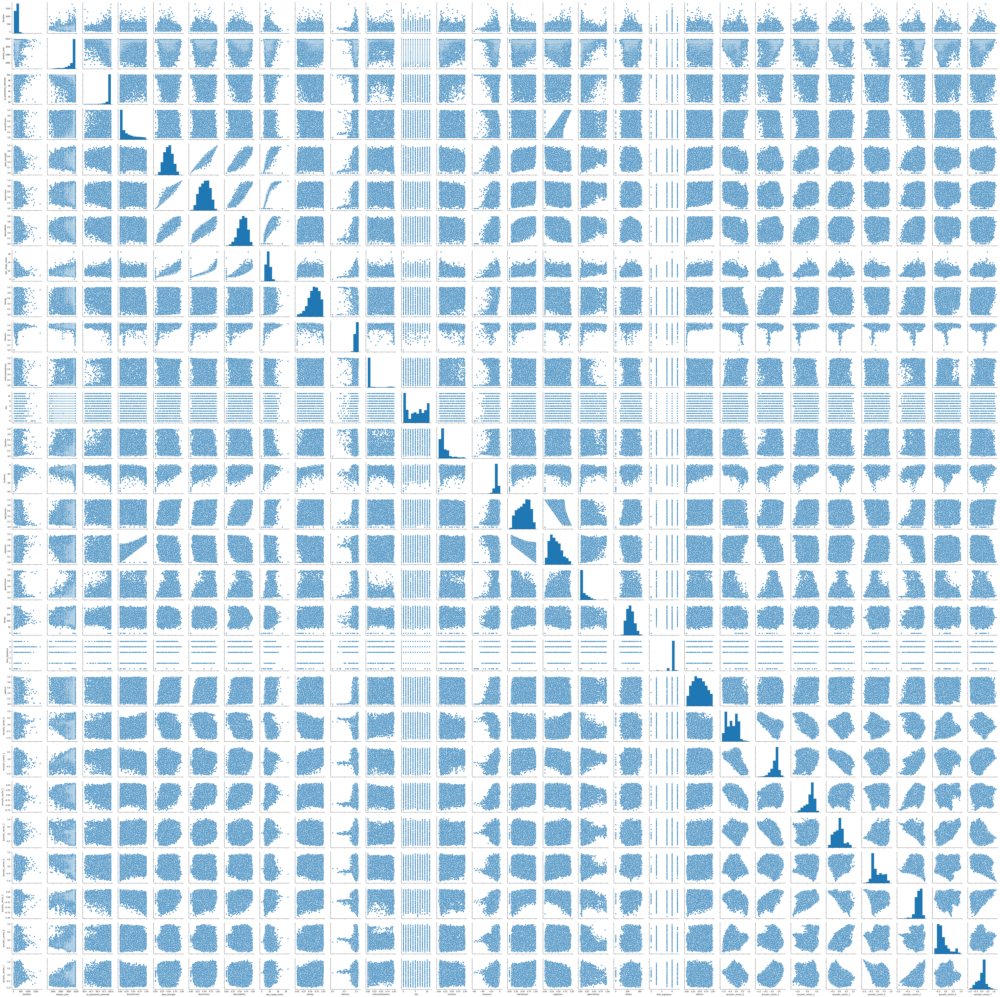

In [193]:
sns.pairplot(df1)
 

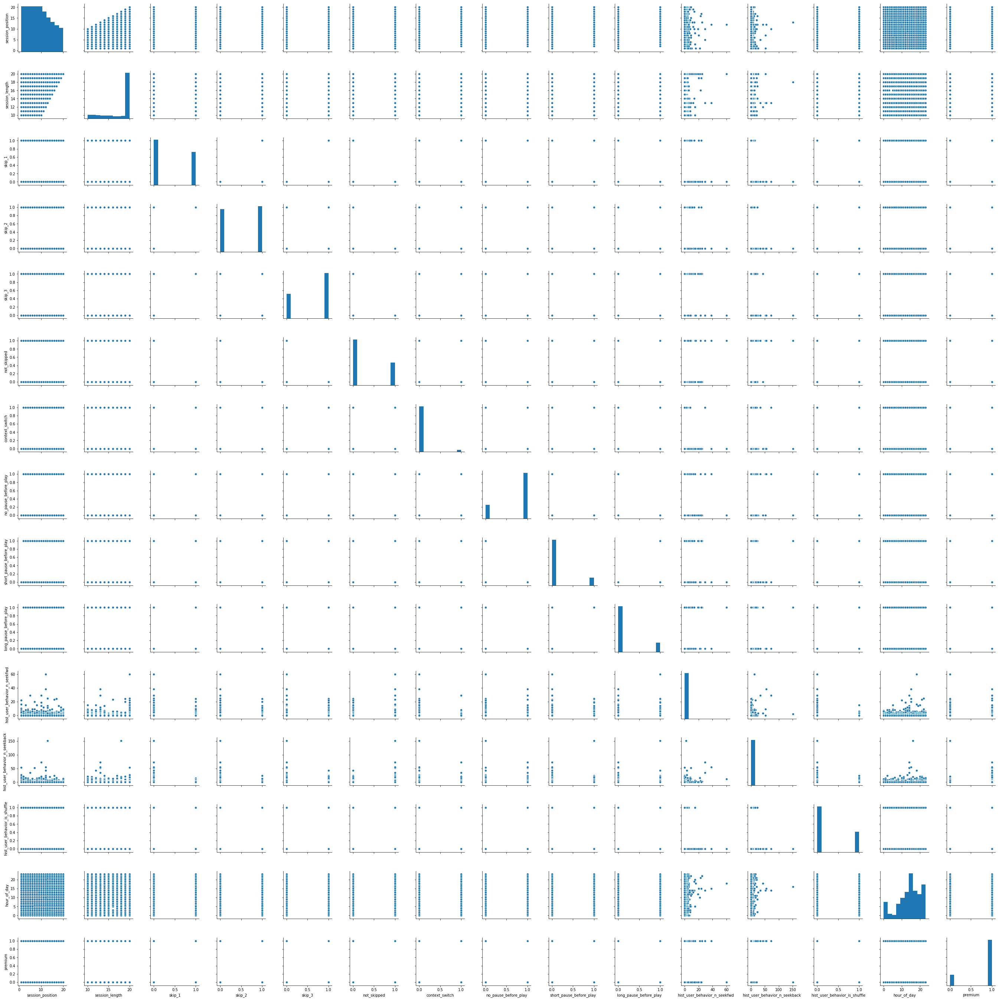

In [194]:
sns.pairplot(
  df.astype({
    "skip_1":"int32",
    "skip_2":"int32",
    "skip_3":"int32",
    "not_skipped":"int32",
    "hist_user_behavior_is_shuffle":"int32",
    "premium":"int32"
})
)
 

#Modeling Spotify Data

In [38]:
# Using skip_2 as the ground truth
df['skipped'] = (df.skip_2 | df.skip_1).astype('int32')
df = df.drop(columns=['skip_1','skip_2','skip_3','not_skipped'])
df.head(30)

,session_id,session_position,session_length,track_id_clean,context_switch,no_pause_before_play,short_pause_before_play,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,hist_user_behavior_is_shuffle,hour_of_day,date,premium,context_type,hist_user_behavior_reason_start,hist_user_behavior_reason_end,skipped
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,0,0,0,0,1,16,2018-07-15,1,editorial_playlist,trackdone,trackdone,0
1,0_00006f66-33e5-4de7-a324-2d18e439fc1e,2,20,t_9099cd7b-c238-47b7-9381-f23f2c1d1043,0,1,0,0,0,0,1,16,2018-07-15,1,editorial_playlist,trackdone,trackdone,0
2,0_00006f66-33e5-4de7-a324-2d18e439fc1e,3,20,t_fc5df5ba-5396-49a7-8b29-35d0d28249e0,0,1,0,0,0,0,1,16,2018-07-15,1,editorial_playlist,trackdone,trackdone,0
3,0_00006f66-33e5-4de7-a324-2d18e439fc1e,4,20,t_23cff8d6-d874-4b20-83dc-94e450e8aa20,0,1,0,0,0,0,1,16,2018-07-15,1,editorial_playlist,trackdone,trackdone,0
4,0_00006f66-33e5-4de7-a324-2d18e439fc1e,5,20,t_64f3743c-f624-46bb-a579-0f3f9a07a123,0,1,0,0,0,0,1,16,2018-07-15,1,editorial_playlist,trackdone,trackdone,0
5,0_00006f66-33e5-4de7-a324-2d18e439fc1e,6,20,t_c815228b-3212-4f9e-9d4f-9cb19b248184,0,1,0,0,0,0,1,16,2018-07-15,1,editorial_playlist,trackdone,fwdbtn,0
6,0_00006f66-33e5-4de7-a324-2d18e439fc1e,7,20,t_e23c19f5-4c32-4557-aa44-81372c2e3705,0,1,0,0,0,0,1,16,2018-07-15,1,editorial_playlist,fwdbtn,fwdbtn,1
7,0_00006f66-33e5-4de7-a324-2d18e439fc1e,8,20,t_0be6eced-f56f-48bd-8086-f2e0b760fdee,0,1,0,0,0,0,1,16,2018-07-15,1,editorial_playlist,fwdbtn,fwdbtn,1
8,0_00006f66-33e5-4de7-a324-2d18e439fc1e,9,20,t_f3ecbd3b-9e8e-4557-b8e0-39cfcd7e65dd,0,1,0,0,0,0,1,16,2018-07-15,1,editorial_playlist,fwdbtn,fwdbtn,1
9,0_00006f66-33e5-4de7-a324-2d18e439fc1e,10,20,t_2af4dfa0-7df3-4b7e-b7ab-353ba48237f9,0,1,0,0,0,0,1,16,2018-07-15,1,editorial_playlist,fwdbtn,fwdbtn,1


In [10]:
df.hist_user_behavior_reason_start = df.hist_user_behavior_reason_start.astype('category')
df.hist_user_behavior_reason_end = df.hist_user_behavior_reason_end.astype('category')
df.context_type = df.context_type.astype('category')
df.date = df.date.apply(pd.to_datetime)

In [39]:
 df1 = df1.drop("mode", axis=1)

In [40]:
df1.iloc[:,1:] = df1.iloc[:,1:].astype('float32')
df1.head()

,track_id,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,...,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
0,t_a540e552-16d4-42f8-a185-232bd650ea7d,109.706673,1950.0,99.975418,0.458040,0.519497,0.504949,0.399767,7.511880,0.817709,...,4.0,0.935512,-0.033284,-0.411896,-0.028580,0.349438,0.832467,-0.213871,-0.299464,-0.675907
1,t_67965da0-132b-4b1e-8a69-0ef99b32287c,187.693329,1950.0,99.969429,0.916272,0.419223,0.545530,0.491235,9.098376,0.154258,...,3.0,0.359675,0.145703,-0.850372,0.123860,0.746904,0.371803,-0.420558,-0.213120,-0.525795
2,t_0614ecd3-a7d5-40a1-816e-156d5872a467,160.839996,1951.0,99.602547,0.812884,0.425890,0.508280,0.491625,8.368670,0.358813,...,4.0,0.726769,0.021720,-0.743634,0.333247,0.568447,0.411094,-0.187749,-0.387599,-0.433496
3,t_070a63a0-744a-434e-9913-a97b02926a29,175.399994,1951.0,99.665016,0.396854,0.400934,0.359990,0.552227,5.967346,0.514585,...,4.0,0.859075,0.039143,-0.267555,-0.051825,0.106173,0.614825,-0.111419,-0.265953,-0.542753
4,t_d6990e17-9c31-4b01-8559-47d9ce476df1,369.600006,1951.0,99.991760,0.728831,0.371328,0.335115,0.483044,5.802681,0.721442,...,4.0,0.562343,0.131931,-0.292523,-0.174819,-0.034422,0.717229,-0.016239,-0.392694,-0.455496


In [41]:
session_data = (
    df[['session_id','session_position','track_id_clean', 'skipped']]
    .merge(
        df1,
        how='left',
        left_on=['track_id_clean'],
        right_on=['track_id']
    ).drop(columns='track_id_clean')
)
session_data.head()

,session_id,session_position,skipped,track_id,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,...,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,0,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,180.066666,2018.0,99.968132,0.015848,0.438551,0.473455,...,4.0,0.152255,-0.815775,0.386409,0.230160,0.028028,-0.333373,0.015452,-0.353590,0.205826
1,0_00006f66-33e5-4de7-a324-2d18e439fc1e,2,0,t_9099cd7b-c238-47b7-9381-f23f2c1d1043,236.796371,2018.0,99.896729,0.061811,0.654804,0.735661,...,4.0,0.337152,-0.713646,0.363718,0.310315,-0.042222,-0.383164,0.066357,-0.365308,0.157920
2,0_00006f66-33e5-4de7-a324-2d18e439fc1e,3,0,t_fc5df5ba-5396-49a7-8b29-35d0d28249e0,231.266663,2018.0,99.999977,0.354116,0.532155,0.540411,...,4.0,0.373862,-0.742541,0.375599,0.252660,-0.049007,-0.299745,0.063341,-0.486689,0.181604
3,0_00006f66-33e5-4de7-a324-2d18e439fc1e,4,0,t_23cff8d6-d874-4b20-83dc-94e450e8aa20,169.826675,2018.0,99.995041,0.769225,0.641756,0.729224,...,4.0,0.649420,-0.705116,0.317562,0.289141,-0.038920,-0.393358,0.092719,-0.364418,0.285603
4,0_00006f66-33e5-4de7-a324-2d18e439fc1e,5,0,t_64f3743c-f624-46bb-a579-0f3f9a07a123,210.545258,2018.0,99.998497,0.006602,0.732428,0.794881,...,4.0,0.652921,-0.868489,0.331280,0.210478,0.084740,-0.333287,-0.025706,-0.510350,0.182315


In [42]:
session_data1 =session_data.drop(columns=['track_id'], axis=1)

In [43]:
session_data1 =session_data.drop(columns=['track_id'], axis=1)
session_data1 =session_data.shift(1)
session_data1 =session_data.groupby('session_id')
session_data1 =session_data.add_prefix('previous_')

In [44]:
full_session_data = pd.concat((session_data,session_data1), axis=1)
full_session_data.head()

,session_id,session_position,skipped,track_id,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,...,previous_time_signature,previous_valence,previous_acoustic_vector_0,previous_acoustic_vector_1,previous_acoustic_vector_2,previous_acoustic_vector_3,previous_acoustic_vector_4,previous_acoustic_vector_5,previous_acoustic_vector_6,previous_acoustic_vector_7
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,0,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,180.066666,2018.0,99.968132,0.015848,0.438551,0.473455,...,4.0,0.152255,-0.815775,0.386409,0.230160,0.028028,-0.333373,0.015452,-0.353590,0.205826
1,0_00006f66-33e5-4de7-a324-2d18e439fc1e,2,0,t_9099cd7b-c238-47b7-9381-f23f2c1d1043,236.796371,2018.0,99.896729,0.061811,0.654804,0.735661,...,4.0,0.337152,-0.713646,0.363718,0.310315,-0.042222,-0.383164,0.066357,-0.365308,0.157920
2,0_00006f66-33e5-4de7-a324-2d18e439fc1e,3,0,t_fc5df5ba-5396-49a7-8b29-35d0d28249e0,231.266663,2018.0,99.999977,0.354116,0.532155,0.540411,...,4.0,0.373862,-0.742541,0.375599,0.252660,-0.049007,-0.299745,0.063341,-0.486689,0.181604
3,0_00006f66-33e5-4de7-a324-2d18e439fc1e,4,0,t_23cff8d6-d874-4b20-83dc-94e450e8aa20,169.826675,2018.0,99.995041,0.769225,0.641756,0.729224,...,4.0,0.649420,-0.705116,0.317562,0.289141,-0.038920,-0.393358,0.092719,-0.364418,0.285603
4,0_00006f66-33e5-4de7-a324-2d18e439fc1e,5,0,t_64f3743c-f624-46bb-a579-0f3f9a07a123,210.545258,2018.0,99.998497,0.006602,0.732428,0.794881,...,4.0,0.652921,-0.868489,0.331280,0.210478,0.084740,-0.333287,-0.025706,-0.510350,0.182315


In [45]:
fsd=full_session_data.drop(columns=["track_id",'session_id','previous_track_id','previous_session_id' ],axis=1)

In [46]:
fsd.head()

,session_position,skipped,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,...,previous_time_signature,previous_valence,previous_acoustic_vector_0,previous_acoustic_vector_1,previous_acoustic_vector_2,previous_acoustic_vector_3,previous_acoustic_vector_4,previous_acoustic_vector_5,previous_acoustic_vector_6,previous_acoustic_vector_7
0,1,0,180.066666,2018.0,99.968132,0.015848,0.438551,0.473455,0.653119,7.660024,...,4.0,0.152255,-0.815775,0.386409,0.230160,0.028028,-0.333373,0.015452,-0.353590,0.205826
1,2,0,236.796371,2018.0,99.896729,0.061811,0.654804,0.735661,0.877393,11.308750,...,4.0,0.337152,-0.713646,0.363718,0.310315,-0.042222,-0.383164,0.066357,-0.365308,0.157920
2,3,0,231.266663,2018.0,99.999977,0.354116,0.532155,0.540411,0.679719,8.065802,...,4.0,0.373862,-0.742541,0.375599,0.252660,-0.049007,-0.299745,0.063341,-0.486689,0.181604
3,4,0,169.826675,2018.0,99.995041,0.769225,0.641756,0.729224,0.864881,11.287586,...,4.0,0.649420,-0.705116,0.317562,0.289141,-0.038920,-0.393358,0.092719,-0.364418,0.285603
4,5,0,210.545258,2018.0,99.998497,0.006602,0.732428,0.794881,0.857778,12.181586,...,4.0,0.652921,-0.868489,0.331280,0.210478,0.084740,-0.333287,-0.025706,-0.510350,0.182315


Model Training & Testing

In [101]:
 
feat = fsd.drop(columns=['skipped','previous_skipped'] ,axis=1)
label = fsd['skipped']
print(X.shape, y.shape)
# split into train test sets
 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

((1000, 20), (1000,))
((670, 20), (330, 20), (670,), (330,))


In [102]:
from sklearn.linear_model import LinearRegression

In [103]:
regressor = LinearRegression()  
regressor.fit(X_train, y_train) #training the algorithm

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [104]:
y_pred = regressor.predict(X_test)

In [105]:
df1 = pd.DataFrame({'Actual': y_test.flatten(), 'Predicted': y_pred.flatten()})
df1

,Actual,Predicted
0,1,0.722527
1,0,-0.015239
2,1,0.967734
3,1,0.698985
4,1,0.194212
5,0,0.444117
6,1,1.188693
7,0,0.336478
8,0,-0.014009
9,1,0.412567


In [106]:
#To retrieve the intercept:
print(regressor.intercept_)

#For retrieving the slope:
print(regressor.coef_)

0.464555573949601
[-0.01480058  0.02164515 -0.00809417  0.01455925 -0.00874222 -0.05626464
  0.02206304 -0.03520802 -0.04326197 -0.02330008 -0.02460485 -0.02180135
 -0.01480337  0.00456578  0.03063407  0.00285693 -0.00183975 -0.01641478
 -0.02168336 -0.012439  ]


In [107]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))


('Mean Absolute Error:', 0.283777961305171)
('Mean Squared Error:', 0.12115937572361578)
('Root Mean Squared Error:', 0.3480795537281898)


In [110]:
# Split the data:
# df -> X, y -> Train, Test, Val
X = fsd.drop(columns=['skipped','previous_skipped'] ,axis=1).fillna(-9999)
y = fsd['skipped']
X_train, X_test, y_train, y_test = train_test_split(
    X,
    y,
    test_size=0.2,
    random_state=2
)
X_train, X_val, y_train, y_val = train_test_split(
    X_train,
    y_train,
    test_size=0.2,
    random_state=2
)
X.head(20)

,session_position,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,...,previous_time_signature,previous_valence,previous_acoustic_vector_0,previous_acoustic_vector_1,previous_acoustic_vector_2,previous_acoustic_vector_3,previous_acoustic_vector_4,previous_acoustic_vector_5,previous_acoustic_vector_6,previous_acoustic_vector_7
0,1,180.066666,2018.0,99.968132,0.015848,0.438551,0.473455,0.653119,7.660024,0.553465,...,4.0,0.152255,-0.815775,0.386409,0.230160,0.028028,-0.333373,0.015452,-0.353590,0.205826
1,2,236.796371,2018.0,99.896729,0.061811,0.654804,0.735661,0.877393,11.308750,0.726828,...,4.0,0.337152,-0.713646,0.363718,0.310315,-0.042222,-0.383164,0.066357,-0.365308,0.157920
2,3,231.266663,2018.0,99.999977,0.354116,0.532155,0.540411,0.679719,8.065802,0.563009,...,4.0,0.373862,-0.742541,0.375599,0.252660,-0.049007,-0.299745,0.063341,-0.486689,0.181604
3,4,169.826675,2018.0,99.995041,0.769225,0.641756,0.729224,0.864881,11.287586,0.529484,...,4.0,0.649420,-0.705116,0.317562,0.289141,-0.038920,-0.393358,0.092719,-0.364418,0.285603
4,5,210.545258,2018.0,99.998497,0.006602,0.732428,0.794881,0.857778,12.181586,0.650057,...,4.0,0.652921,-0.868489,0.331280,0.210478,0.084740,-0.333287,-0.025706,-0.510350,0.182315
5,6,216.689484,2018.0,99.997604,0.098337,0.548632,0.658323,0.596480,10.416269,0.557129,...,5.0,0.661081,-0.817504,0.283297,0.387589,0.279636,-0.280334,0.117993,0.106159,0.311233
6,7,186.453323,2018.0,99.861565,0.449629,0.487708,0.608612,0.557520,9.834414,0.469350,...,4.0,0.109420,-0.748412,0.321976,0.237488,0.003480,-0.315287,0.032431,-0.464694,0.200836
7,8,214.047348,2018.0,97.243820,0.017628,0.649367,0.682610,0.489405,9.900208,0.715155,...,4.0,0.389913,-0.921928,0.359740,0.293674,0.115302,-0.274987,0.043193,-0.444351,0.211909
8,9,218.260818,2018.0,99.998451,0.030127,0.818798,0.879947,0.964383,15.037571,0.555280,...,4.0,0.338321,-0.744412,0.308700,0.230126,0.066493,-0.242549,0.025370,-0.403210,0.159350
9,10,60.000000,2018.0,99.957436,0.332467,0.751500,0.843354,0.914082,14.457762,0.239318,...,4.0,0.257672,-0.647221,0.316101,0.251329,-0.041532,-0.252359,0.059971,-0.313696,0.126421


In [111]:
from sklearn.preprocessing import StandardScaler

In [112]:
#LogisticRegression
scaler = StandardScaler().fit(X_train)
sX_train = scaler.transform(X_train)
sX_val = scaler.transform(X_val)
sX_test = scaler.transform(X_test)

log = LogisticRegressionCV(
    cv=3
).fit(
    sX_train,
    y_train
)

print("Log Train score: %s" % log.score(sX_train,y_train))
print("Log Val score:   %s" % log.score(sX_val,y_val))
print("Log Test score:  %s" % log.score(sX_test,y_test))

/usr/local/lib/python2.7/dist-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype int64, float32 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: Data with input dtype int64, float32 were all converted to float64 by StandardScaler.
  
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:3: DataConversionWarning: Data with input dtype int64, float32 were all converted to float64 by StandardScaler.
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:4: DataConversionWarning: Data with input dtype int64, float32 were all converted to float64 by StandardScaler.
  after removing the cwd from sys.path.


Log Train score: 0.5329802779148013
Log Val score:   0.5286847101746026
Log Test score:  0.5302597093161783


In [113]:
log

LogisticRegressionCV(Cs=10, class_weight=None, cv=3, dual=False,
           fit_intercept=True, intercept_scaling=1.0, max_iter=100,
           multi_class='warn', n_jobs=None, penalty='l2',
           random_state=None, refit=True, scoring=None, solver='lbfgs',
           tol=0.0001, verbose=0)

In [114]:
for pair in sorted(zip(X.columns,log.coef_[0]),key=lambda p: np.abs(p[1]),reverse=True):
    print("%30s | % .8f" % pair)

              session_position |  0.03630309
     previous_session_position |  0.03630309
                  release_year | -0.01741420
         previous_release_year | -0.01741420
                 beat_strength | -0.01559707
        previous_beat_strength | -0.01559707
                      duration |  0.01485159
             previous_duration |  0.01485159
             acoustic_vector_5 | -0.01271588
    previous_acoustic_vector_5 | -0.01271588
             acoustic_vector_6 | -0.01054709
    previous_acoustic_vector_6 | -0.01054709
                  acousticness | -0.01035854
         previous_acousticness | -0.01035854
             acoustic_vector_1 |  0.00977300
    previous_acoustic_vector_1 |  0.00977300
             acoustic_vector_0 | -0.00973502
    previous_acoustic_vector_0 | -0.00973502
             acoustic_vector_4 | -0.00971490
    previous_acoustic_vector_4 | -0.00971490
        us_popularity_estimate | -0.00807465
previous_us_popularity_estimate | -0.00807465
         

In [115]:
rfc = RandomForestClassifier(
    n_estimators=100
).fit(
    X_train,
    y_train
)

print("RFC Train score: %s" % rfc.score(X_train,y_train))
print("RFC Val score:   %s" % rfc.score(X_val,y_val))
print("RFC Test score:  %s" % rfc.score(X_test,y_test))

RFC Train score: 0.8773768416741901
RFC Val score:   0.5286474814787238
RFC Test score:  0.5225458660948297


In [116]:
for pair in sorted(zip(X.columns,rfc.feature_importances_),key=lambda p:p[1],reverse=True):
    print("%30s | % .8f" % pair)

     previous_session_position |  0.17766274
              session_position |  0.17709770
previous_us_popularity_estimate |  0.01552188
        us_popularity_estimate |  0.01532799
             previous_duration |  0.01382674
                      duration |  0.01364344
                      liveness |  0.01342522
             previous_liveness |  0.01331618
         previous_acousticness |  0.01284443
             acoustic_vector_6 |  0.01284353
                      loudness |  0.01280169
             previous_loudness |  0.01278729
    previous_acoustic_vector_6 |  0.01273096
              previous_valence |  0.01272505
                  acousticness |  0.01271606
                         tempo |  0.01267902
                previous_tempo |  0.01266499
                   speechiness |  0.01263120
                       valence |  0.01261009
             acoustic_vector_4 |  0.01260096
    previous_acoustic_vector_2 |  0.01259572
          previous_speechiness |  0.01258599
    previ

In [117]:
# Train a XGBoost model and score
xgb = XGBClassifier(
    n_estimators=100000
).fit(
    X_train,
    y_train,
    eval_set=[(X_train, y_train),(X_val, y_val)],
    early_stopping_rounds=10,
    verbose=True
)

print("XGB Train score: %s" % xgb.score(X_train,y_train))
print("XGB Val score:   %s" % xgb.score(X_val,y_val))
print("XGB Test score:  %s" % xgb.score(X_test,y_test))

[0]	validation_0-error:0.46232	validation_1-error:0.469082
Multiple eval metrics have been passed: 'validation_1-error' will be used for early stopping.

Will train until validation_1-error hasn't improved in 10 rounds.
[1]	validation_0-error:0.46043	validation_1-error:0.468114
[2]	validation_0-error:0.460337	validation_1-error:0.467443
[3]	validation_0-error:0.461072	validation_1-error:0.467965
[4]	validation_0-error:0.459602	validation_1-error:0.465768
[5]	validation_0-error:0.458997	validation_1-error:0.465508
[6]	validation_0-error:0.456344	validation_1-error:0.463646
[7]	validation_0-error:0.456354	validation_1-error:0.463423
[8]	validation_0-error:0.457964	validation_1-error:0.463721
[9]	validation_0-error:0.456279	validation_1-error:0.461077
[10]	validation_0-error:0.456782	validation_1-error:0.461226
[11]	validation_0-error:0.456726	validation_1-error:0.461264
[12]	validation_0-error:0.455674	validation_1-error:0.461003
[13]	validation_0-error:0.455981	validation_1-error:0.4606

In [118]:
for pair in sorted(zip(X.columns,xgb.feature_importances_),key=lambda p:p[1],reverse=True):
    print("%30s | % .8f" % pair)

              session_position |  0.16317865
             acoustic_vector_0 |  0.08804975
             acoustic_vector_3 |  0.06423934
        us_popularity_estimate |  0.05426485
                  release_year |  0.05297749
             acoustic_vector_1 |  0.04601258
                      duration |  0.04036637
                    bounciness |  0.03670857
             acoustic_vector_4 |  0.03433225
                      flatness |  0.03238685
                       valence |  0.03073057
                      liveness |  0.02869390
                 beat_strength |  0.02760312
              instrumentalness |  0.02739333
             acoustic_vector_7 |  0.02595819
                  acousticness |  0.02540444
                   speechiness |  0.02514140
             acoustic_vector_5 |  0.02452301
                      loudness |  0.02385062
                  danceability |  0.02372088
             acoustic_vector_6 |  0.02312798
                     mechanism |  0.02270099
          

In [119]:
# Train a LightGBM model and score
lgbm = LGBMClassifier(
    n_estimators=100000
).fit(
    X_train,
    y_train,
    eval_set=[(X_train, y_train),(X_val, y_val)],
    early_stopping_rounds=10,
    verbose=True
)

print()
print("LGBM Train score: %s" % lgbm.score(X_train,y_train))
print("LGBM Val score:   %s" % lgbm.score(X_val,y_val))
print("LGBM Test score:  %s" % lgbm.score(X_test,y_test))

[1]	training's binary_logloss: 0.691171	valid_1's binary_logloss: 0.691566
Training until validation scores don't improve for 10 rounds.
[2]	training's binary_logloss: 0.690005	valid_1's binary_logloss: 0.690746
[3]	training's binary_logloss: 0.689026	valid_1's binary_logloss: 0.690061
[4]	training's binary_logloss: 0.688174	valid_1's binary_logloss: 0.689518
[5]	training's binary_logloss: 0.68741	valid_1's binary_logloss: 0.689042
[6]	training's binary_logloss: 0.686754	valid_1's binary_logloss: 0.6886
[7]	training's binary_logloss: 0.686183	valid_1's binary_logloss: 0.688252
[8]	training's binary_logloss: 0.685662	valid_1's binary_logloss: 0.68798
[9]	training's binary_logloss: 0.685187	valid_1's binary_logloss: 0.687832
[10]	training's binary_logloss: 0.684713	valid_1's binary_logloss: 0.687602
[11]	training's binary_logloss: 0.684295	valid_1's binary_logloss: 0.687459
[12]	training's binary_logloss: 0.683874	valid_1's binary_logloss: 0.687264
[13]	training's binary_logloss: 0.68351

In [120]:
for pair in sorted(zip(X.columns,lgbm.feature_importances_),key=lambda p:p[1],reverse=True):
    print("%34s | % 5d" % pair)

            us_popularity_estimate |   100
                          duration |    75
                  session_position |    70
                 acoustic_vector_2 |    68
                         mechanism |    66
                      release_year |    65
                          loudness |    65
                 acoustic_vector_4 |    60
                      acousticness |    59
                           valence |    58
                 acoustic_vector_6 |    57
                            energy |    56
                  instrumentalness |    53
                          liveness |    51
                 acoustic_vector_7 |    51
                       speechiness |    50
                 acoustic_vector_0 |    50
                 acoustic_vector_1 |    50
                      danceability |    44
                 acoustic_vector_3 |    43
                 acoustic_vector_5 |    43
                          organism |    41
                             tempo |    38
           

In [121]:
lgbm_feature_importances = [[p[0], int(p[1])] for p in sorted(zip(X.columns,lgbm.feature_importances_),key=lambda p:p[1],reverse=True)]
lgbm_feature_importances[:5]

[['us_popularity_estimate', 100],
 ['duration', 75],
 ['session_position', 70],
 ['acoustic_vector_2', 68],
 ['mechanism', 66]]

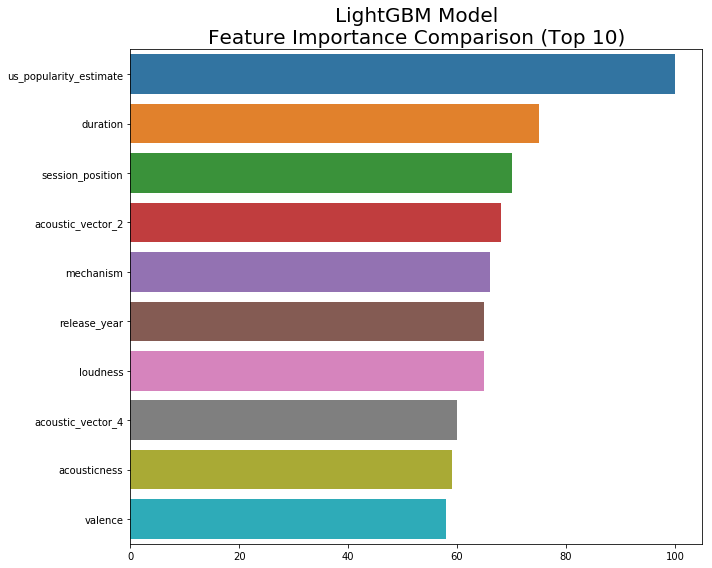

In [123]:
fi = pd.DataFrame(lgbm_feature_importances,columns=['Feature','Importance'])
plt.figure(figsize=(10,8))
sns.barplot(
    "Importance",
    "Feature",
    data=fi.head(10)
)
plt.title(
    "LightGBM Model\nFeature Importance Comparison (Top 10)",
    fontsize=20
)
plt.xlabel(
    "",
    fontsize=15
)
plt.ylabel(
    "",
    fontsize=15
)
# plt.xticks(rotation=90)
plt.tight_layout()
#plt.savefig("images/lgbm_feature_importance_top10.png")
plt.show()

In [161]:

def predict_proba(X):
    predictions = (
        log.predict_proba(scaler.transform(X))[:,1] +
        rfc.predict_proba(X)[:,1] +
        xgb.predict_proba(X)[:,1] +
        lgbm.predict_proba(X)[:,1]
        
    )
    return predictions / 4

def predict(X,threshold=0.5):
    return (predict_proba(X) > threshold).astype('float32')

def score(X,y):
    return accuracy_score(y,predict(X))

print("Ensemble Train Accuracy:  %.3f" % score(X_train,y_train))
print("Ensemble Val Accuracy:    %.3f" % score(X_val,y_val))
print("Ensemble Test Accuracy:   %.3f" % score(X_test,y_test))

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: Data with input dtype int64, float32 were all converted to float64 by StandardScaler.
  


Ensemble Train Accuracy:  0.862
Ensemble Val Accuracy:    0.536
Ensemble Test Accuracy:   0.531


In [130]:
ensamble_predictions = predict(X_test)

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: Data with input dtype int64, float32 were all converted to float64 by StandardScaler.
  


In [131]:
from sklearn.metrics import precision_score, recall_score, f1_score

In [132]:
lgbm_preds = lgbm.predict(X_test)

print("LightGBM Test Precision Score: %.3f" % precision_score(y_test,lgbm_preds))
print("LightGBM Test Recall Score:    %.3f" % recall_score(y_test,lgbm_preds))
print("LightGBM Test F1 Score:        %.3f" % f1_score(y_test,lgbm_preds))

LightGBM Test Precision Score: 0.549
LightGBM Test Recall Score:    0.728
LightGBM Test F1 Score:        0.626


In [133]:
print("Ensemble Test Precision Score: %.3f" % precision_score(y_test,ensamble_predictions))
print("Ensemble Test Recall Score:    %.3f" % recall_score(y_test,ensamble_predictions))
print("Ensemble Test F1 Score:        %.3f" % f1_score(y_test,ensamble_predictions))

Ensemble Test Precision Score: 0.540
Ensemble Test Recall Score:    0.633
Ensemble Test F1 Score:        0.583


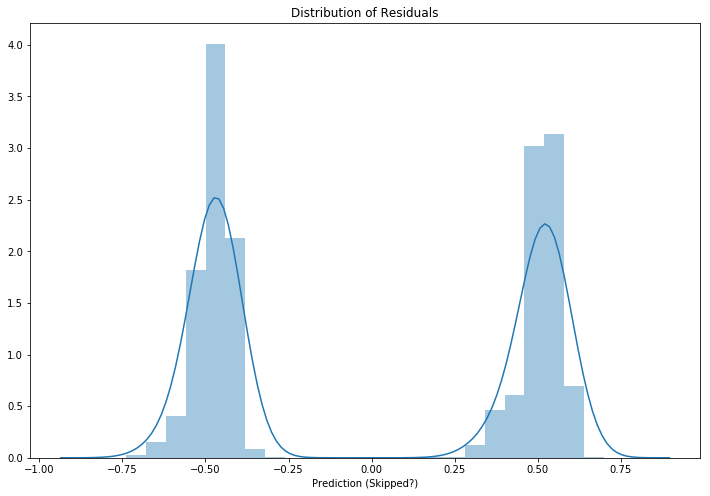

In [134]:
lgbm_probs = lgbm.predict_proba(X_test)[:,1]
lgmb_residuals = (lgbm_probs - y_test).sort_values()

plt.figure(figsize=(12,8))
sns.distplot(lgmb_residuals)
plt.title("Distribution of Residuals")
plt.xlabel("Prediction (Skipped?)")
plt.show()

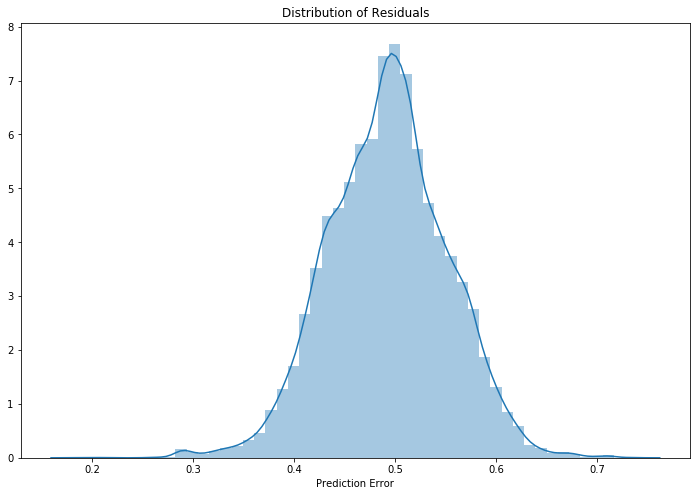

In [135]:
plt.figure(figsize=(12,8))
sns.distplot(np.abs(lgmb_residuals))
plt.title("Distribution of Residuals")
plt.xlabel("Prediction Error")
plt.show()

In [150]:

acoustic = {
    "Willie Nelson": 0.48,
    "Wu-Tang Clan": 0.032,
    "John Coltrane": 0.732
    }

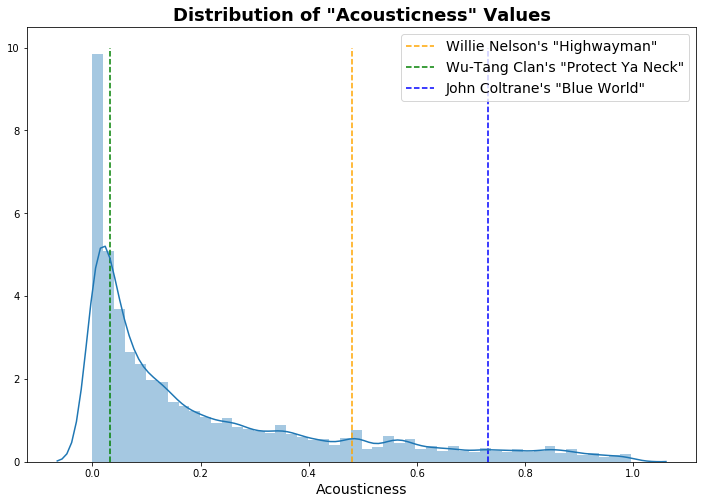

In [151]:

plt.figure(figsize=(12,8))
sns.distplot(
    full_session_data.acousticness
)
plt.title(
    "Distribution of \"Acousticness\" Values",
    fontweight='bold',
    fontsize=18
)

plt.vlines(
    0.48,
    0,
    10,
    label="Willie Nelson's \"Highwayman\"",
    colors='orange',
    linestyles='dashed'
)
plt.vlines(
    0.032,
    0,
    10,
    label="Wu-Tang Clan's \"Protect Ya Neck\"",
    colors='green',
    linestyles='dashed'
)
plt.vlines(
    0.732,
    0,
    10,
    label="John Coltrane's \"Blue World\"",
    colors='blue',
    linestyles='dashed'
)
plt.legend(
    fontsize=14
)
plt.xlabel(
    "Acousticness",
    fontsize=14
)
#plt.savefig("images/feature_eda/acousticness_distribution.png")
plt.show()

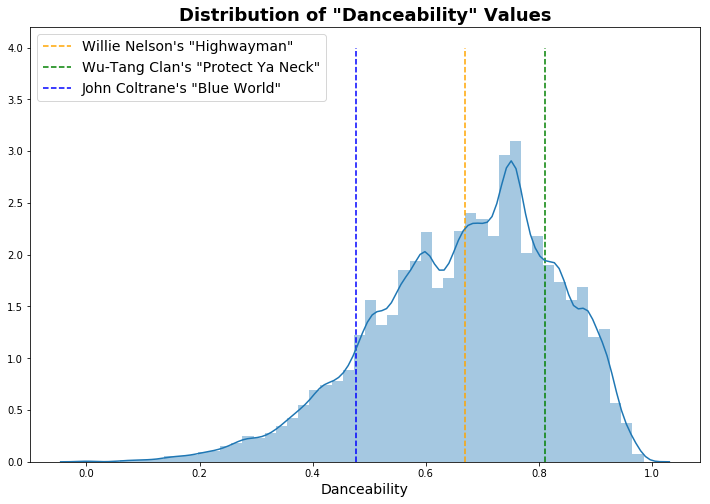

In [152]:
plt.figure(figsize=(12,8))
sns.distplot(
    full_session_data.danceability
)
plt.title(
    "Distribution of \"Danceability\" Values",
    fontweight='bold',
    fontsize=18
)

plt.vlines(
    0.67,
    0,
    4,
    label="Willie Nelson's \"Highwayman\"",
    colors='orange',
    linestyles='dashed'
)
plt.vlines(
    0.81,
    0,
    4,
    label="Wu-Tang Clan's \"Protect Ya Neck\"",
    colors='green',
    linestyles='dashed'
)
plt.vlines(
    0.477,
    0,
    4,
    label="John Coltrane's \"Blue World\"",
    colors='blue',
    linestyles='dashed'
)
plt.legend(
    fontsize=14,
    loc=2
)
plt.xlabel(
    "Danceability",
    fontsize=14
)
#plt.savefig("images/feature_eda/danceability_distribution.png")
plt.show()

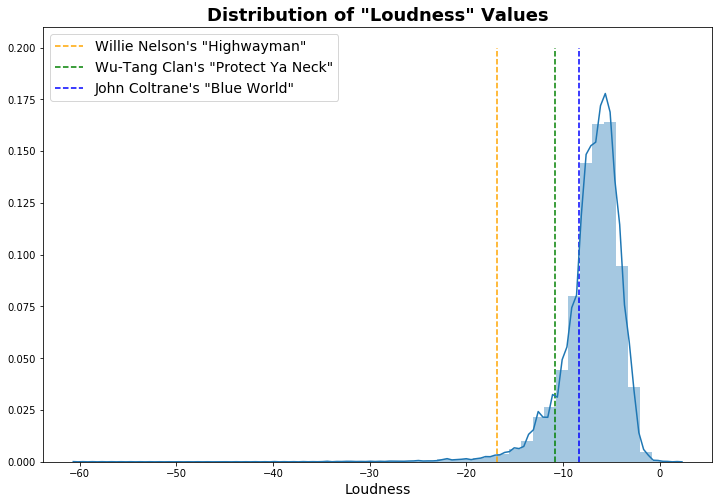

In [153]:
plt.figure(figsize=(12,8))
sns.distplot(
    full_session_data.loudness
)
plt.title(
    "Distribution of \"Loudness\" Values",
    fontweight='bold',
    fontsize=18
)

plt.vlines(
    -16.842,
    0,
    0.2,
    label="Willie Nelson's \"Highwayman\"",
    colors='orange',
    linestyles='dashed'
)
plt.vlines(
    -10.8,
    0,
    0.2,
    label="Wu-Tang Clan's \"Protect Ya Neck\"",
    colors='green',
    linestyles='dashed'
)
plt.vlines(
    -8.301,
    0,
    0.2,
    label="John Coltrane's \"Blue World\"",
    colors='blue',
    linestyles='dashed'
)
plt.legend(
    fontsize=14,
    loc=2
)
plt.xlabel(
    "Loudness",
    fontsize=14
)
#plt.savefig("images/feature_eda/loudness_distribution.png")
plt.show()

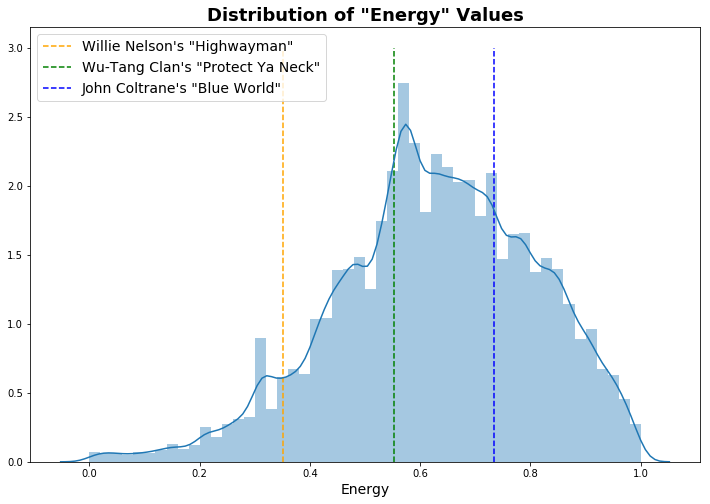

In [154]:

plt.figure(figsize=(12,8))
sns.distplot(
    full_session_data.energy
)
plt.title(
    "Distribution of \"Energy\" Values",
    fontweight='bold',
    fontsize=18
)

plt.vlines(
    0.351,
    0,
    3,
    label="Willie Nelson's \"Highwayman\"",
    colors='orange',
    linestyles='dashed'
)
plt.vlines(
    0.552,
    0,
    3,
    label="Wu-Tang Clan's \"Protect Ya Neck\"",
    colors='green',
    linestyles='dashed'
)
plt.vlines(
    0.733,
    0,
    3,
    label="John Coltrane's \"Blue World\"",
    colors='blue',
    linestyles='dashed'
)
plt.legend(
    fontsize=14,
    loc=2
)
plt.xlabel(
    "Energy",
    fontsize=14
)
#plt.savefig("images/feature_eda/energy_distribution.png")
plt.show()

# Adding EDA plots for the presentation
ROC Curve for Naive model vs Logistic Regression vs XGB model

In [155]:
log_probs = log.predict_proba(scaler.transform(X_test))[:,1]
lgb_probs = lgbm.predict_proba(X_test)[:,1]

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:1: DataConversionWarning: Data with input dtype int64, float32 were all converted to float64 by StandardScaler.
  """Entry point for launching an IPython kernel.


In [156]:
from sklearn.metrics import roc_curve, roc_auc_score

In [157]:
log_fpr, log_tpr, _ = roc_curve(y_test, log_probs)
lgb_fpr, lgb_tpr, _ = roc_curve(y_test, lgb_probs)

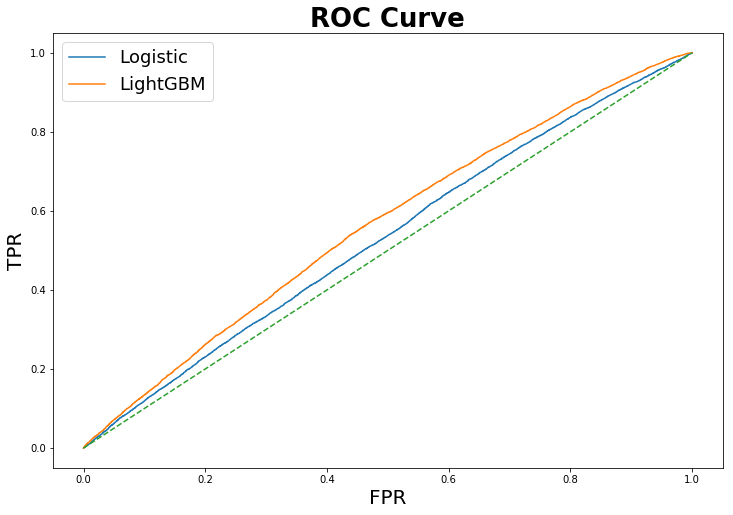

In [158]:
plt.figure(figsize=(12,8))
plt.plot(
    log_fpr,
    log_tpr,
    label="Logistic"
    
)
plt.plot(
    lgb_fpr,
    lgb_tpr,
    label="LightGBM"
)
plt.plot(
    np.linspace(0,1,10),
    np.linspace(0,1,10),
    label="",
    linestyle="dashed"
)
plt.legend(
    fontsize=18
)
plt.title(
    "ROC Curve",
    fontsize=26,
    fontweight='bold'
)
plt.xlabel(
    "FPR",
    fontsize=20
)
plt.ylabel(
    "TPR",
    fontsize=20
)

#plt.savefig("images/roc_curve.png")
plt.show()